# Process and Plot

In [34]:
%pip install matplotlib
%pip install hdbscan
%pip install seaborn
%pip install colorcet
%pip install ipywidgets


[notice] A new release of pip is available: 23.0.1 -> 24.0
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.

[notice] A new release of pip is available: 23.0.1 -> 24.0
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.

[notice] A new release of pip is available: 23.0.1 -> 24.0
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.

[notice] A new release of pip is available: 23.0.1 -> 24.0
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.

[notice] A new release of pip is available: 23.0.1 -> 24.0
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


In [2]:
import csv
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

In [3]:
%pwd

'/Users/binchoi/Documents/office-work/yale-bids/projects/bike/bike-tools/notebooks'

In [6]:
filename = './testdata/PD1-46k.tsv'
PID_IDX, MESH_TERMS_IDX, MESH_TOPICS_IDX, X_IDX, Y_IDX = 0, -4, -3, -2, -1, 


# get_points reads testdata and extracts the pid, x, y, mesh-terms, mesh-topics values of each row
def get_points():
    points = []
    with open(filename, 'r', newline='') as file:
        reader = csv.reader(file, delimiter='\t')
        next(reader)  # Skip the first row (header)
        for row in reader:
            points.append(
                (
                    float(row[X_IDX]), 
                    float(row[Y_IDX]), 
                ),
            )
    return np.array(points)


In [7]:
points = get_points()
print(np.shape(points))

(46763, 2)


In [10]:
min_x, min_y = np.min(points, axis=0)
max_x, max_y = np.max(points, axis=0)

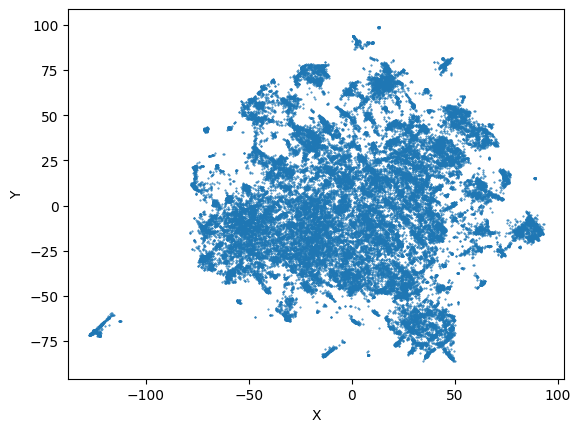

In [13]:
BORDER_BUFFER = 10

x_coords = points[:,0]
y_coords = points[:,1]

plt.scatter(x_coords, y_coords, s=.2)

plt.xlabel('X')
plt.xlim(min_x-BORDER_BUFFER, max_x+BORDER_BUFFER)

plt.ylabel('Y')
plt.ylim(min_y-BORDER_BUFFER, max_y+BORDER_BUFFER)

plt.show()

# HDBSCAN (Hierarchical Density-Based Spatial Clustering of Applications with Noise)
To run HDBSCAN in Python, the best approach is to use the hdbscan package from the scikit-learn-contrib repository. This package provides a high-performance implementation of the HDBSCAN algorithm and integrates seamlessly with the scikit-learn API, making it easy to use alongside other scikit-learn tools.

The hdbscan package is optimized for performance and is faster than many other implementations, including the reference Java implementation and some C/C++ implementations

While scikit-learn also provides an implementation of HDBSCAN, there are some differences in the results due to variations in the implementation details. The hdbscan package from scikit-learn-contrib is generally preferred for its performance and additional features.


## Demo

In [19]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.datasets import make_blobs
import hdbscan
import colorcet as cc

In [15]:
sns.set_context('poster')
sns.set_style('white')
sns.set_color_codes()
plot_kwds = {'alpha' : 0.5, 's' : 8, 'linewidths':0}

In [17]:
# Generate sample data
centers = [[-0.85, -0.85], [-0.85, 0.85], [3, 3], [3, -3]]
X, _ = make_blobs(n_samples=750, centers=centers, cluster_std=[0.2, 0.35, 1.35, 1.35], random_state=0)

# Create and fit the HDBSCAN clusterer
clusterer = hdbscan.HDBSCAN(min_cluster_size=10)
clusterer.fit(X)

# Plot the single linkage tree
# clusterer.single_linkage_tree_.plot(cmap='viridis', colorbar=True)
# plt.title('Single Linkage Tree')
# plt.show()

clusters_at_level1 = hdbscan.recursive_extract_clusters(condensed_tree, 0.1)
clusters_at_level2 = hdbscan.recursive_extract_clusters(condensed_tree, 0.3)
clusters_at_level3 = hdbscan.recursive_extract_clusters(condensed_tree, 0.5)

plt.figure()
for cluster in clusters_at_level1:
    plt.scatter(X[cluster, 0], X[cluster, 1], s=10)
plt.title("Clusters at Level 1 (cut=0.1)")

# Visualize clusters at level 2
plt.figure()
for cluster in clusters_at_level2:
    plt.scatter(X[cluster, 0], X[cluster, 1], s=10)
plt.title("Clusters at Level 2 (cut=0.3)")

# Visualize clusters at level 3
plt.figure()
for cluster in clusters_at_level3:
    plt.scatter(X[cluster, 0], X[cluster, 1], s=10)
plt.title("Clusters at Level 3 (cut=0.5)")



AttributeError: module 'hdbscan' has no attribute 'recursive_extract_clusters'

In [22]:
import seaborn as snsimport 
import sklearn.datasets as data

%matplotlib inline

sns.set_context('poster')
sns.set_style('white')
sns.set_color_codes()
plot_kwds = {'alpha' : 0.5, 's' : 8, 'linewidths':0}

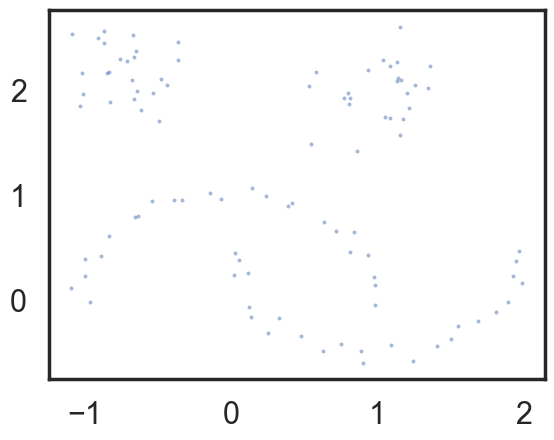

In [23]:
moons, _ = data.make_moons(n_samples=50, noise=0.05)
blobs, _ = data.make_blobs(n_samples=50, centers=[(-0.75,2.25), (1.0, 2.0)], cluster_std=0.25)
test_data = np.vstack([moons, blobs])
plt.scatter(test_data.T[0], test_data.T[1], color='b', **plot_kwds)


<Axes: >

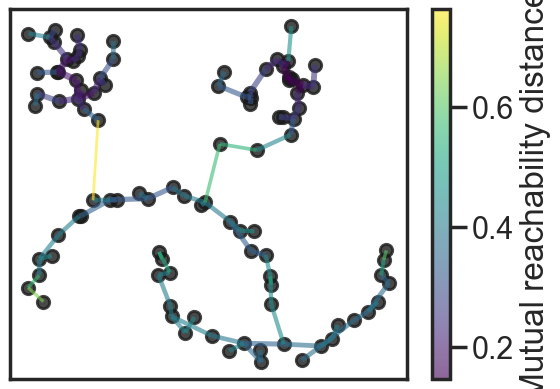

In [27]:
import hdbscan
clusterer = hdbscan.HDBSCAN(min_cluster_size=5, gen_min_span_tree=True)
clusterer.fit(test_data)

clusterer.minimum_spanning_tree_.plot(edge_cmap='viridis', edge_alpha=0.6, node_size=80, edge_linewidth=2)


In [58]:
# clusterer.single_linkage_tree_.plot(cmap='viridis', colorbar=True)
print(clusterer.single_linkage_tree_)
clusterer.single_linkage_tree_.get_clusters(cut_distance=1, min_cluster_size=3)

labels = clusterer.single_linkage_tree_.get_clusters(cut_distance=1, min_cluster_size=2)
print(labels)

[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1  0 -1 -1 -1 -1  0 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1  0 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1  1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1  1 -1 -1]


<Axes: ylabel='$\\lambda$ value'>

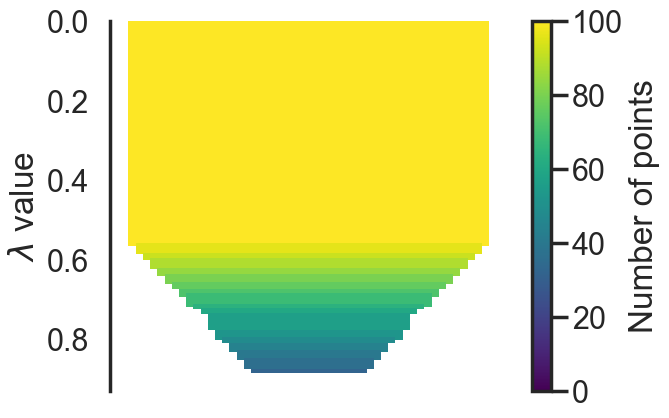

In [51]:
clusterer.min_cluster_size=30
clusterer.fit(test_data)

clusterer.condensed_tree_.plot()

## Key Parameters and Methods
- min_cluster_size: This parameter sets the smallest size grouping that you wish to consider a cluster. Smaller values will result in more fine-grained clusters.
- min_samples: This parameter controls how conservative the clustering is. Smaller values make the algorithm more liberal in finding dense areas, resulting in more clusters.
- cluster_selection_epsilon: This parameter helps merge clusters that are close to each other. It ensures that clusters below the given threshold are not split up any further.

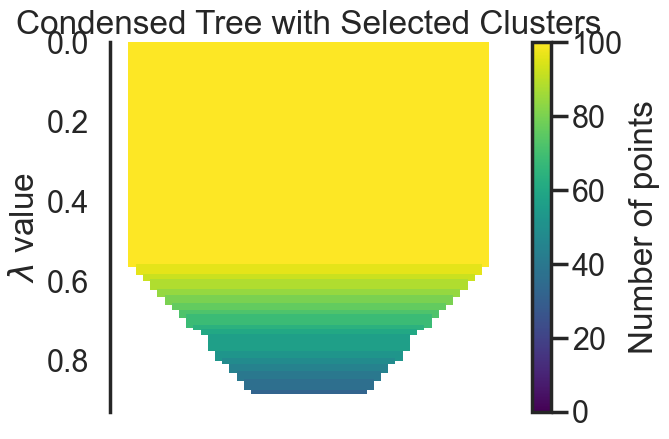

In [60]:
# Plot the condensed tree
clusterer.condensed_tree_.plot(select_clusters=True, selection_palette=sns.color_palette())
plt.title('Condensed Tree with Selected Clusters')
plt.show()

ValueError: 'c' argument has 100 elements, which is inconsistent with 'x' and 'y' with size 750.

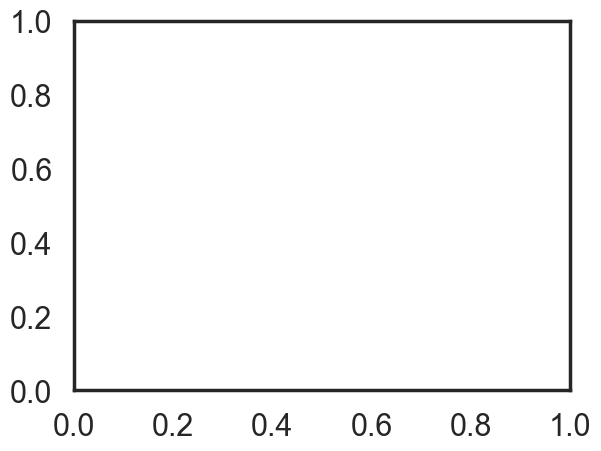

In [61]:
palette = sns.color_palette()
cluster_colors = [sns.desaturate(palette[col], sat) if col >= 0 else (0.5, 0.5, 0.5) 
                  for col, sat in zip(clusterer.labels_, clusterer.probabilities_)]
plt.scatter(X[:, 0], X[:, 1], c=cluster_colors, **plot_kwds)
plt.title('HDBSCAN Clustering')
plt.show()

HDBSCAN (Hierarchical Density-Based Spatial Clustering of Applications with Noise) is a powerful clustering algorithm that extends DBSCAN by allowing for clusters of varying densities. Here are the key hyperparameters of the HDBSCAN algorithm, along with their meanings and guidelines on how to adjust them:

## Key Hyperparameters

### 1. `min_cluster_size`
- **Description**: The minimum number of points required to form a cluster. Clusters smaller than this size will be considered noise.
- **Default**: 5
- **Adjustment Guidelines**: 
  - **Smaller Values**: May result in more clusters, including smaller and potentially spurious clusters.
  - **Larger Values**: More robust to noise, but may miss smaller clusters. Useful for datasets with high variance and significant overlap.
  - **Example**: `HDBSCAN(min_cluster_size=30)`

### 2. `min_samples`
- **Description**: The number of samples in a neighborhood for a point to be considered a core point, including the point itself. It defaults to the value of `min_cluster_size` if not specified.
- **Default**: Same as `min_cluster_size`
- **Adjustment Guidelines**:
  - **Smaller Values**: More sensitive to local density variations, potentially leading to more clusters.
  - **Larger Values**: Increases robustness to noise but may ignore smaller clusters.
  - **Example**: `HDBSCAN(min_samples=10)`

### 3. `cluster_selection_epsilon`
- **Description**: A distance threshold to cut the cluster hierarchy tree to form flat clusters.
- **Default**: 0.0
- **Adjustment Guidelines**: 
  - **Smaller Values**: More fine-grained clusters.
  - **Larger Values**: Coarser clusters.
  - **Example**: `HDBSCAN(cluster_selection_epsilon=0.5)`

### 4. `metric`
- **Description**: The distance metric to use for clustering.
- **Default**: 'euclidean'
- **Adjustment Guidelines**: 
  - **Common Metrics**: 'euclidean', 'manhattan', 'cosine', etc.
  - **Example**: `HDBSCAN(metric='manhattan')`

### 5. `alpha`
- **Description**: A distance scaling parameter for the reachability distance computation.
- **Default**: 1.0
- **Adjustment Guidelines**: 
  - **Smaller Values**: More sensitive to local density variations.
  - **Larger Values**: Smoother density estimates.
  - **Example**: `HDBSCAN(alpha=1.5)`

### 6. `cluster_selection_method`
- **Description**: Method to select clusters from the condensed tree. Options are 'eom' (excess of mass) and 'leaf'.
- **Default**: 'eom'
- **Adjustment Guidelines**: 
  - **'eom'**: Extracts the most stable clusters.
  - **'leaf'**: Selects clusters from the bottom of the leaf nodes, resulting in smaller, more homogeneous clusters.
  - **Example**: `HDBSCAN(cluster_selection_method='leaf')`

### 7. `allow_single_cluster`
- **Description**: Whether to allow a single cluster to encompass all points.
- **Default**: False
- **Adjustment Guidelines**: 
  - **True**: Useful if you expect a single large cluster.
  - **False**: Forces the algorithm to find multiple clusters.
  - **Example**: `HDBSCAN(allow_single_cluster=True)`

### 8. `approx_min_span_tree`
- **Description**: Whether to use an approximate minimum spanning tree.
- **Default**: True
- **Adjustment Guidelines**: 
  - **True**: Faster computation.
  - **False**: More accurate but slower.
  - **Example**: `HDBSCAN(approx_min_span_tree=False)`

## Our Data

In [46]:
plot_kwds = {'alpha' : 0.5, 's' : 3, 'linewidths':0}
palette = sns.color_palette(cc.glasbey, n_colors=400)
cluster_colors = [sns.desaturate(palette[col], sat) if col >= 0 else (0.5, 0.5, 0.5) 
                  for col, sat in zip(clusterer.labels_, clusterer.probabilities_)]

# fine-grain
hdb_params = {
    'fine-grain':{'min_cluster_size':20, 'min_samples':10, 'cluster_selection_epsilon':0.1},
    'coarse-grain':{'min_cluster_size':100, 'min_samples':50, 'cluster_selection_epsilon':0.5},
    }

In [47]:
# Our data
X = points[:,1:]

# Create and fit the HDBSCAN clusterer
clusterer = hdbscan.HDBSCAN(**hdb_params['coarse-grain'])
clusterer.fit(X)

HDBSCAN(cluster_selection_epsilon=0.5, min_cluster_size=100, min_samples=50)

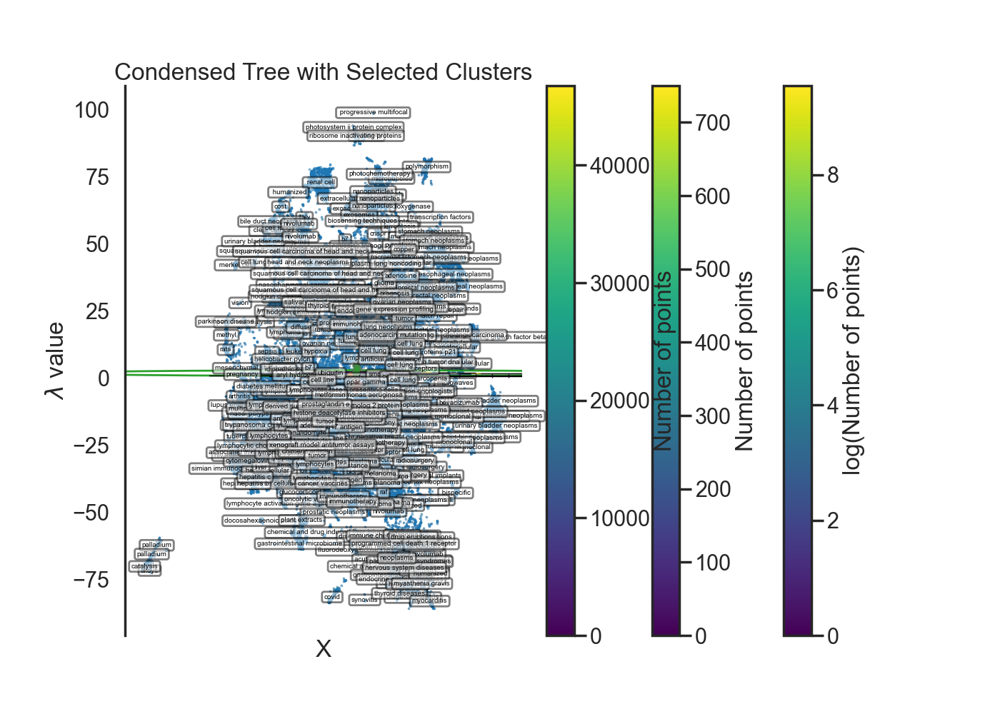

In [48]:
# Plot the condensed tree
clusterer.condensed_tree_.plot(select_clusters=True, selection_palette=sns.color_palette(cc.glasbey, n_colors=174))
plt.title('Condensed Tree with Selected Clusters')
plt.show()

In [49]:
# Print Result Statistics
cluster_labels = clusterer.fit_predict(X)

num_clusters = len(set(cluster_labels)) - (-1 in cluster_labels)
num_noise_points = sum(cluster_labels == -1)

print(f"Number of clusters: {num_clusters}")
print(f"Number of points: {len(cluster_labels)}")
print(f"Number of noise points: {num_noise_points}")

Number of clusters: 75
Number of points: 46763
Number of noise points: 11341


ValueError: 'c' argument has 100 elements, which is inconsistent with 'x' and 'y' with size 750.

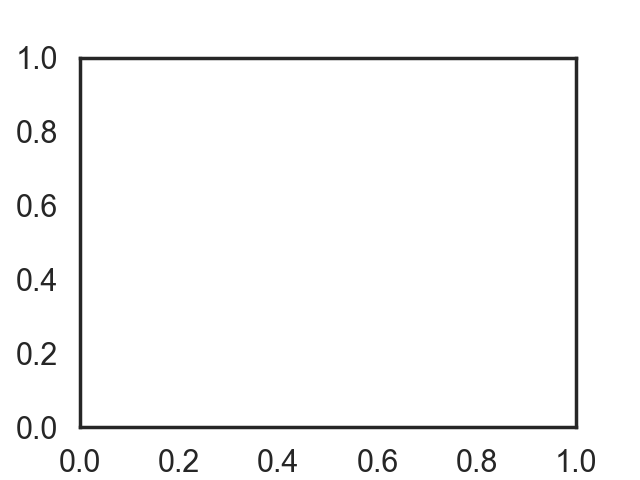

In [62]:
%matplotlib widget
cluster_colors = [sns.desaturate(palette[col], sat) if col >= 0 else (0.5, 0.5, 0.5) 
                  for col, sat in zip(clusterer.labels_, clusterer.probabilities_)]
plt.scatter(X[:,0], X[:,1], c=cluster_colors, **plot_kwds)
plt.title('HDBSCAN Clustering')
plt.show()

In [51]:
%matplotlib inline

# Note
- ~10K points HDB Scan works. However, 46K seems to raise 'maximum recursion depth exceeded' error~
- ~even with same number of points, min_cluster_size = 10 didn't raise error but 30 did~

This was because I was attempting to plot single linkage tree

## Let's mark the center of each cluster with the cluster number

{0: array([-123.22907146,  -68.51423583]), 1: array([-11.86296203, -81.61074678]), 2: array([45.40191875, 78.51727604]), 3: array([-70.99124344,  41.97751639]), 4: array([ 62.89343241, -42.84749491]), 5: array([ 3.4746545 , 91.16044868]), 6: array([  1.45628322, -64.27738389]), 7: array([36.03531827, 63.67473269]), 8: array([ 72.58770738, -25.77352705]), 9: array([ 85.77142555, -13.14772404]), 10: array([-19.45912079,  72.88088233]), 11: array([ 60.75803056, -24.04492778]), 12: array([ 62.95313492, -13.83296095]), 13: array([-31.40758462, -59.46064864]), 14: array([ 43.71008086, -45.2184555 ]), 15: array([ 35.56315531, -69.5968879 ]), 16: array([74.00921655, 16.02886259]), 17: array([63.34236447,  8.22927416]), 18: array([-76.07807872,  20.76026525]), 19: array([-76.35147488,  10.51791896]), 20: array([-1.81656593, 49.09067008]), 21: array([56.44438934, 44.03142437]), 22: array([ 8.09242834, 49.02942551]), 23: array([15.90866475, 69.16857031]), 24: array([ 0.48659458, 63.33855259]), 25

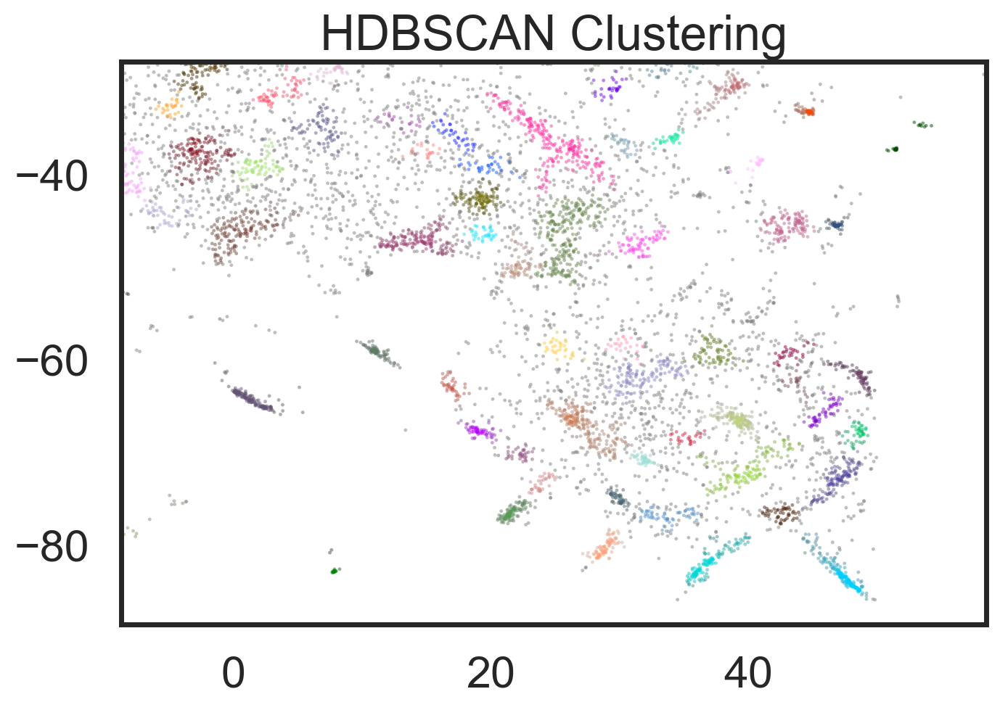

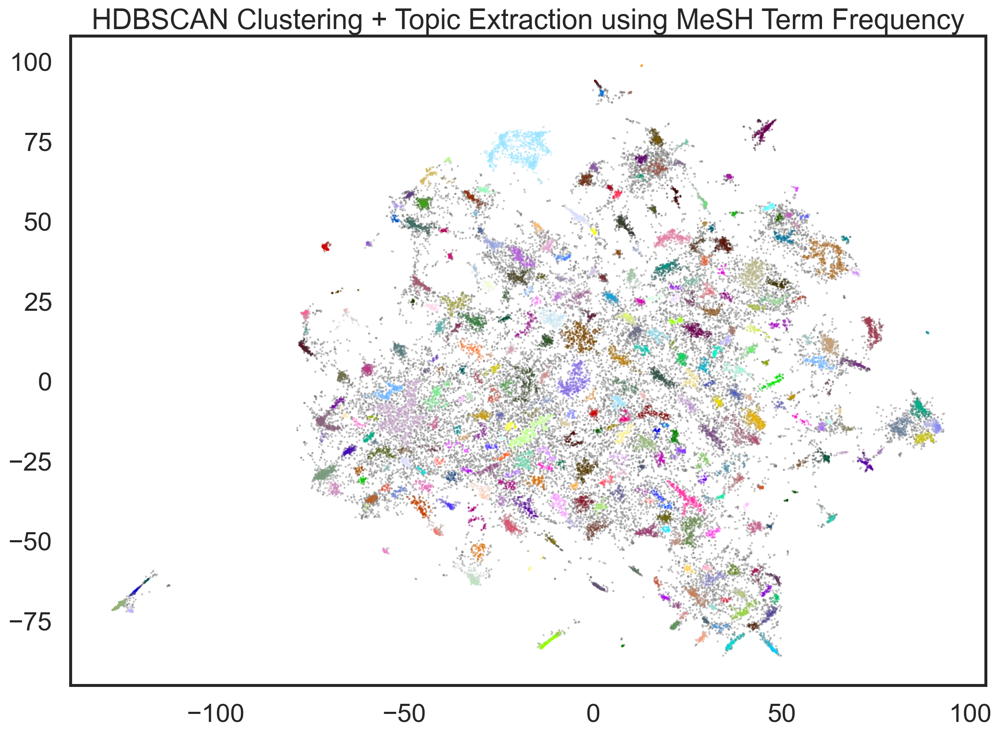

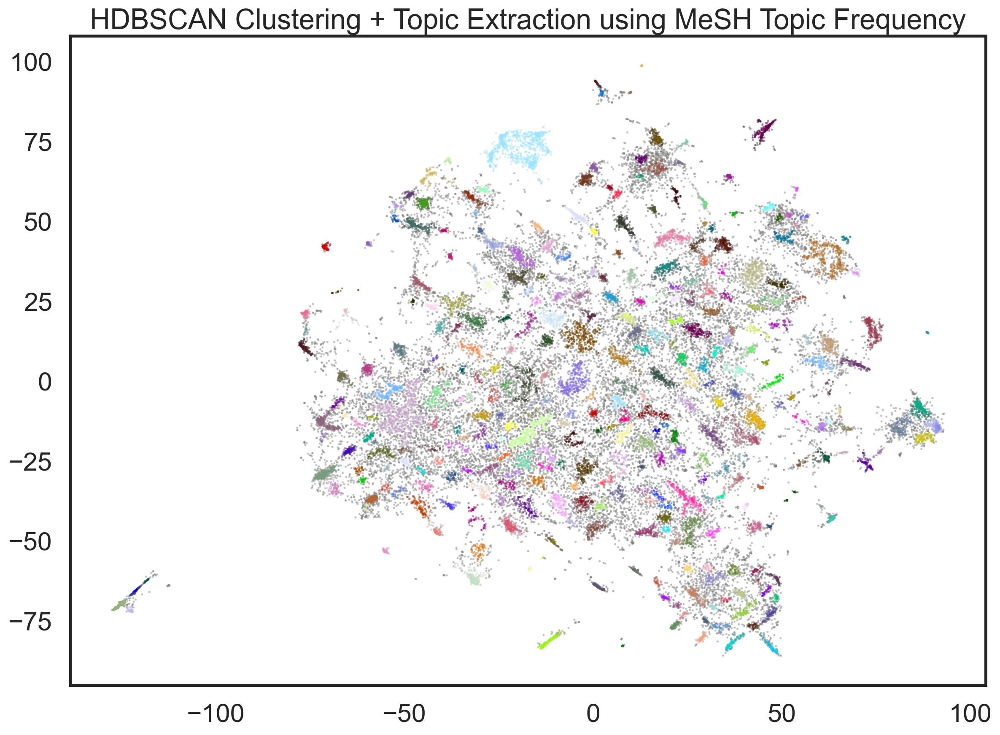

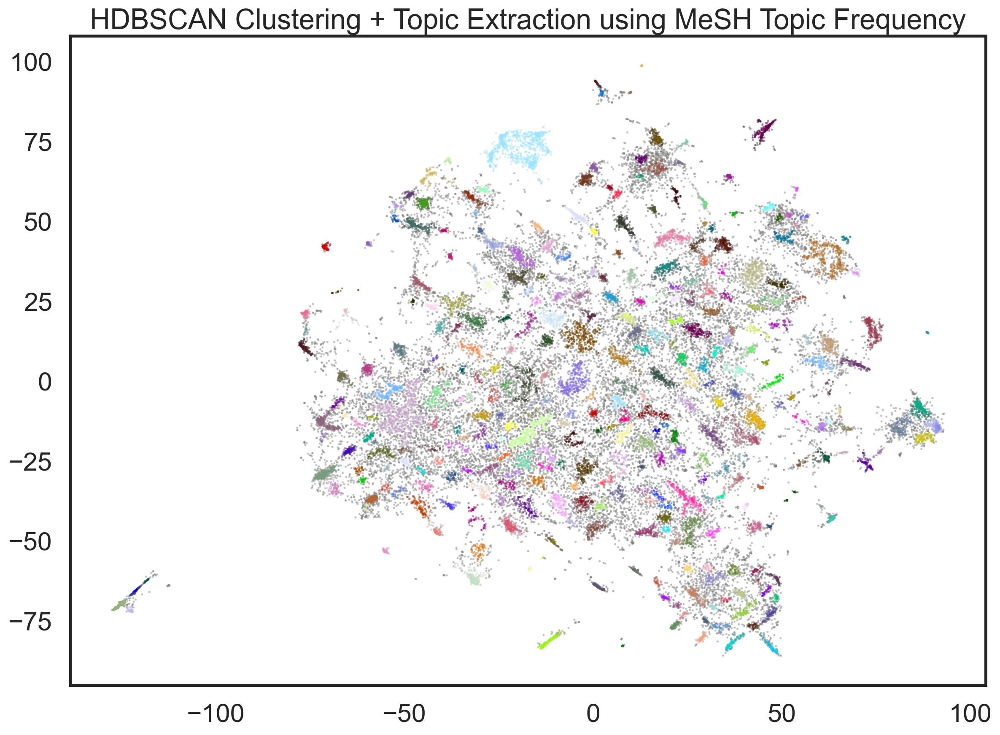

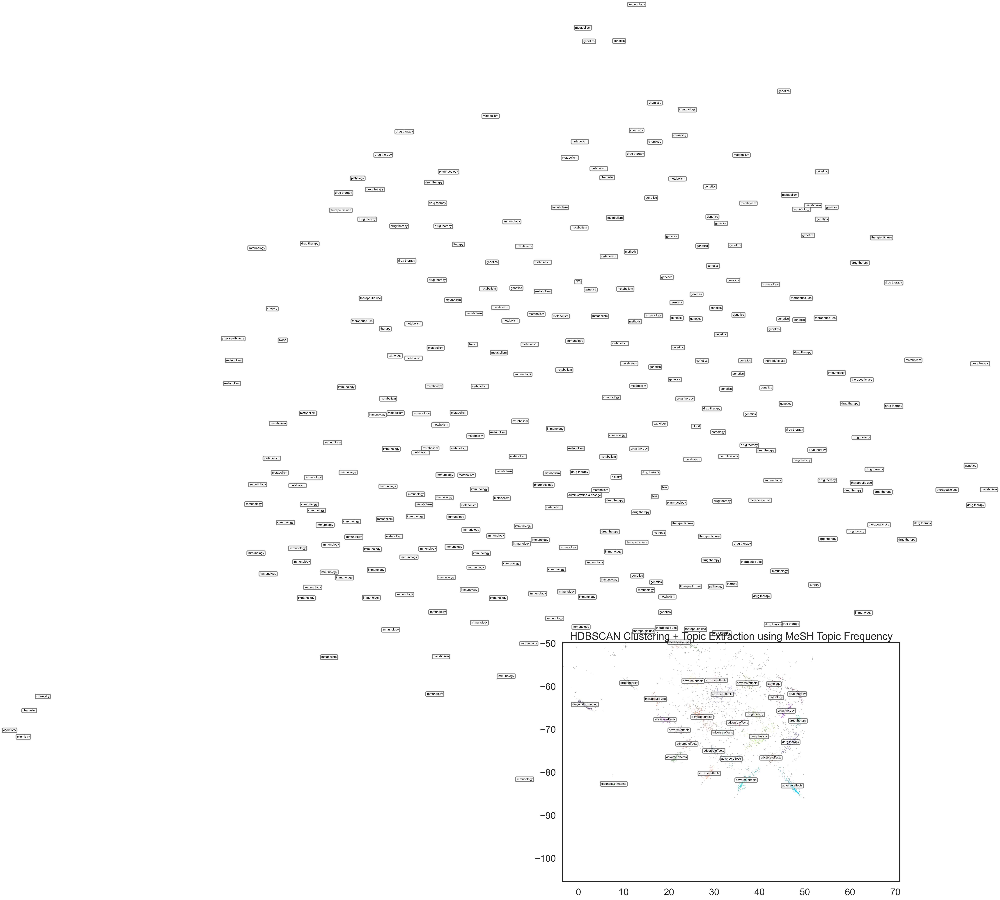

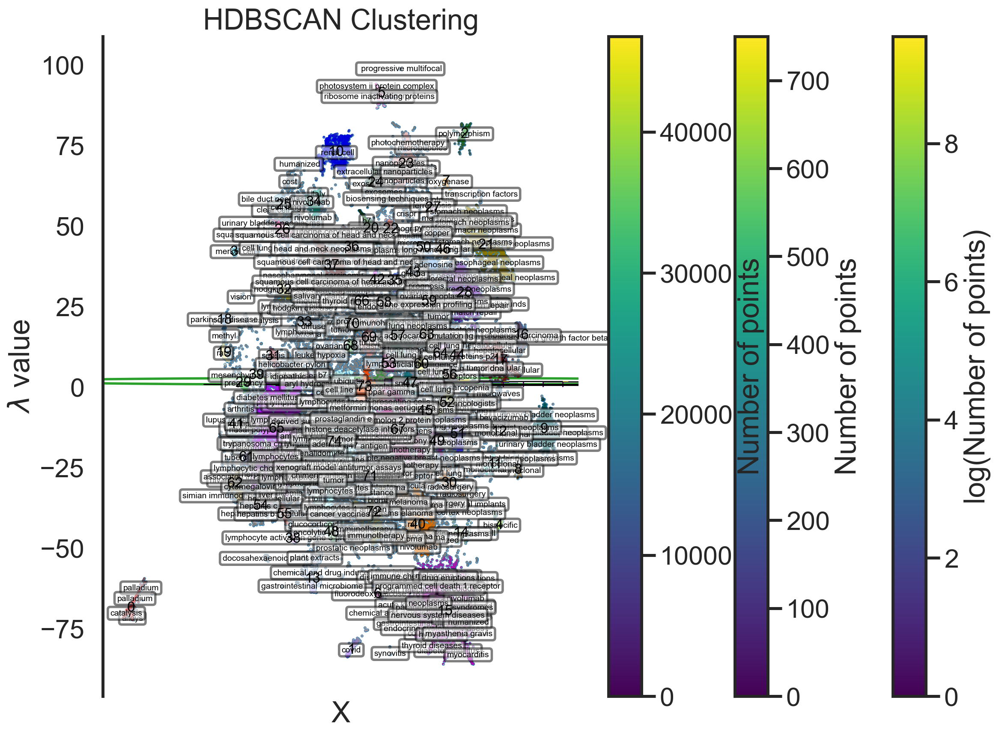

In [52]:
unique_labels = set(clusterer.labels_)
unique_labels.remove(-1)

label_to_cluster_centers = {}
for label in unique_labels:
    cluster_points = X[clusterer.labels_ == label]
    cluster_center = cluster_points.mean(axis=0)
    label_to_cluster_centers[label]= cluster_center

print(label_to_cluster_centers)

plt.scatter(X[:, 0], X[:, 1], c=cluster_colors, **plot_kwds)
plt.title('HDBSCAN Clustering')

# Mark the cluster centers
for label, center in label_to_cluster_centers.items():
    plt.text(center[0], center[1], label, fontsize=12, color='black', ha='center', va='center')

plt.show()

## NOTE
The parameters for adjusting the sensitivity and fine/coarse-grain clustering takes in absolute values. This is not a scalable/robust solution when the number of points is variable. We should wrap the HDBSCAN operation such that the number of points in the dataset is considered in determining the appropriate parameters for the scan. (e.g. defined proportional)

TL;DR settings for HDBSCAN should be determined with consideration of dataset size

# Cluster Topic Determination

In [53]:
from collections import Counter
from collections import defaultdict

No such comm: 316b202ce67f42d68f2955d3543e15ed


In [ ]:
def get_points_df():
    points = []
    with open(filename, 'r', newline='') as file:
        reader = csv.reader(file, delimiter='\t')
        next(reader)  # Skip the first row (header)
        for row in reader:
            points.append({
                'pid': int(row[PID_IDX]),
                'x': float(row[X_IDX]),
                'y': float(row[Y_IDX]),
                'mesh_terms': row[MESH_TERMS_IDX],
                'mesh_topics': row[MESH_TOPICS_IDX]
            })
    return pd.DataFrame(points)

df = get_points_df()

In [ ]:
cluster_terms = defaultdict(list)
for index, label in enumerate(clusterer.labels_):
    cluster_terms[label].extend([t for t in df.iloc[index, df.columns.get_loc('mesh_terms')].split(';')])

for i in range(26):    
    term_counts = Counter(cluster_terms[i])
    for t, cnt in term_counts.most_common(5):
        print(t)
    print("======")


Carcinoma, Merkel Cell
Humans
Skin Neoplasms
Male
Aged
Humans
Lung Neoplasms
Carcinoma, Non-Small-Cell Lung
Antibodies, Monoclonal

Humans
Female
Male
Middle Aged
Arthritis, Rheumatoid
Humans
Transforming Growth Factor beta
B7-H1 Antigen
Immunologic Factors

Humans
COVID-19
SARS-CoV-2
Male
Female
Docosahexaenoic Acids
Humans
Animals
Mice
Male
Humans
Programmed Cell Death 1 Receptor
Polymorphism, Single Nucleotide
Genetic Predisposition to Disease
Female
Humans
JC Virus
Leukoencephalopathy, Progressive Multifocal
Middle Aged
Antibodies, Monoclonal, Humanized
Humans
Treatment Outcome
Male
Retrospective Studies
Adult
Palladium
Antineoplastic Agents
Humans
Coordination Complexes
DNA

Palladium
Catalysis
Ligands
Organometallic Compounds
Humans
Antibodies, Bispecific
Animals
Mice
Neoplasms
Phylogeny

Bayes Theorem
Humans
Animals

Alloys
Models, Chemical
Temperature
Palladium

Catalysis
Palladium
Oxidation-Reduction
Alloys
Indoleamine-Pyrrole 2,3,-Dioxygenase
Humans
Female
B7-H1 Antigen
Male


In [ ]:
BLACKLIST_TOPICS = {'Human', 'Humans', 'Mice', 'Female', 'Male', 'Aged', 'Middle Aged', 'Animals', 'Adult', ''}

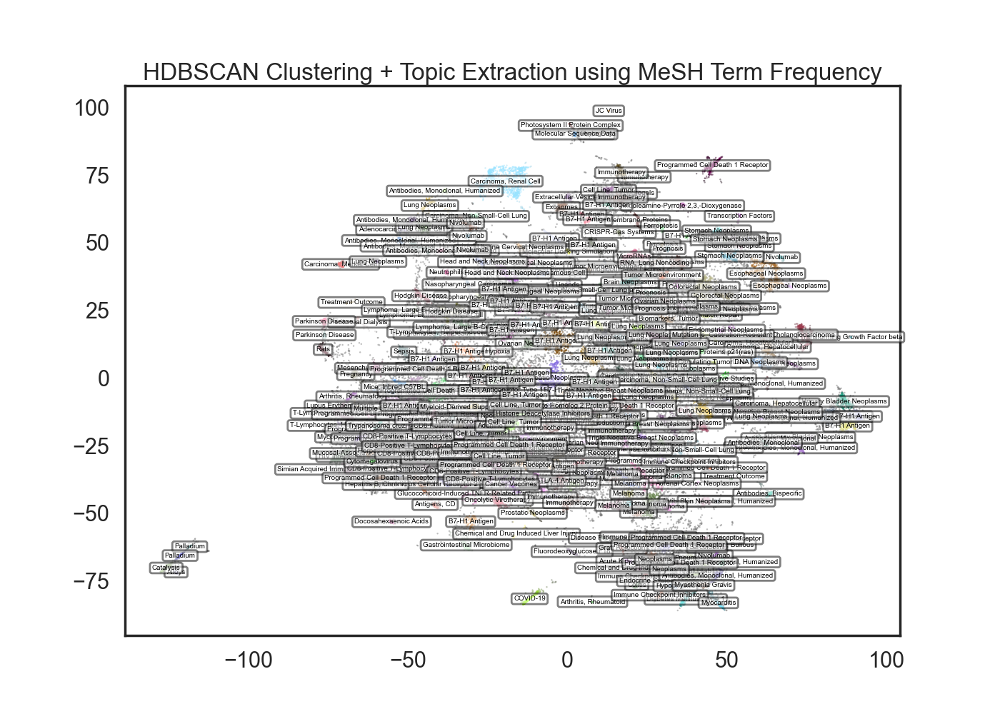

In [ ]:
def get_cluster_centers(clusterer, X):
    unique_labels = set(clusterer.labels_)
    unique_labels.remove(-1)

    cluster_centers = {}
    for label in unique_labels:
        cluster_points = X[clusterer.labels_ == label]
        cluster_center = cluster_points.mean(axis=0)
        cluster_centers[label]= cluster_center
    return cluster_centers


def get_cluster_topics_by_frequency(clusterer, df, mesh_fieldname):
    unique_labels = set(clusterer.labels_)
    unique_labels.remove(-1)

    cluster_terms = defaultdict(list)
    for index, label in enumerate(clusterer.labels_):
        cluster_terms[label].extend([t for t in df.iloc[index, df.columns.get_loc(mesh_fieldname)].split(';')])

    cluster_topics = {}
    for l in unique_labels:
        term_counter = Counter(cluster_terms[l])
        for t, cnt in term_counter.most_common(20):
            # naive filter
            if t not in BLACKLIST_TOPICS:
                cluster_topics[l] = t
                break
    return cluster_topics

%matplotlib widget

plt.figure(figsize=(14, 10))

plt.scatter(X[:, 0], X[:, 1], c=cluster_colors, **plot_kwds)
plt.title('HDBSCAN Clustering + Topic Extraction using MeSH Term Frequency')

cluster_topics = get_cluster_topics_by_frequency(clusterer, df, 'mesh_terms')

for label, center in get_cluster_centers(clusterer, X).items():
    plt.text(center[0], center[1], cluster_topics.get(label, 'N/A'), # TODO: currently handling as N/A
         fontsize=7, color='black', ha='center', va='center',
         bbox=dict(facecolor='white', edgecolor='black', boxstyle='round', alpha=0.5))

plt.show()

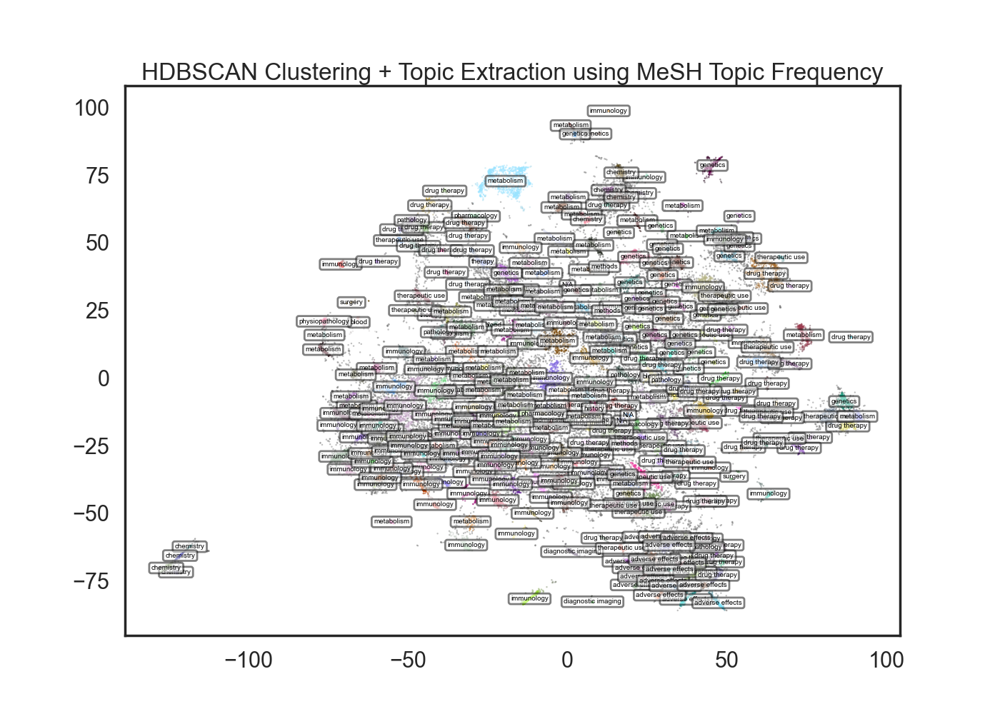

In [ ]:
plt.figure(figsize=(14, 10))

%matplotlib widget
plt.scatter(X[:, 0], X[:, 1], c=cluster_colors, **plot_kwds)
plt.title('HDBSCAN Clustering + Topic Extraction using MeSH Topic Frequency')

cluster_topics = get_cluster_topics_by_frequency(clusterer, df, 'mesh_topics')

for label, center in get_cluster_centers(clusterer, X).items():
    plt.text(center[0], center[1], cluster_topics.get(label, 'N/A'), # TODO: currently handling as N/A
         fontsize=7, color='black', ha='center', va='center',
         bbox=dict(facecolor='white', edgecolor='black', boxstyle='round', alpha=0.5))


plt.show()

# Using TF-IDF for determining Cluster Topics

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer

# Sample data: list of documents (each document is a string)
documents = [
    "Data Science is the sexiest job of the 21st century",
    "Machine learning is the key for data science",
    "Data science and machine learning are closely related fields"
]

# Initialize the TfidfVectorizer
vectorizer = TfidfVectorizer()

# Fit and transform the documents
tfidf_matrix = vectorizer.fit_transform(documents)

# Get feature names (words)
feature_names = vectorizer.get_feature_names_out()

# Convert the TF-IDF matrix to a dense format and print it
dense_tfidf = tfidf_matrix.todense()

# Print the TF-IDF scores for each document
for i, doc in enumerate(dense_tfidf):
    print(f"Document {i+1}:")
    scores = zip(feature_names, doc.tolist()[0])
    sorted_scores = sorted(scores, key=lambda x: x[1], reverse=True)
    for word, score in sorted_scores[:5]:  # Top 5 words
        print(f"  {word}: {score:.4f}")



Document 1:
  the: 0.5190
  21st: 0.3412
  century: 0.3412
  job: 0.3412
  of: 0.3412
Document 2:
  for: 0.4467
  key: 0.4467
  is: 0.3397
  learning: 0.3397
  machine: 0.3397
Document 3:
  and: 0.3820
  are: 0.3820
  closely: 0.3820
  fields: 0.3820
  related: 0.3820


In [18]:
from sklearn.feature_extraction.text import TfidfVectorizer

BLACKLIST_TOPICS_LOWER = {topic.lower() for topic in BLACKLIST_TOPICS}

def get_cluster_topics_by_tfidf(clusterer, df, mesh_fieldname):
    unique_labels = set(clusterer.labels_)
    unique_labels.remove(-1)

    cluster_terms = defaultdict(list)
    for index, label in enumerate(clusterer.labels_):
        cluster_terms[label].extend([t.replace(' ', '_') for t in df.iloc[index, df.columns.get_loc(mesh_fieldname)].split(';')])

    ordered_labels = list(cluster_terms.keys())

    documents = [' '.join(cluster_terms[l]) for l in ordered_labels]
    vectorizer = TfidfVectorizer()
    tfidf_matrix = vectorizer.fit_transform(documents)

    # TODO: need to exclude -1 (noise) from tfidf

    feature_names = vectorizer.get_feature_names_out()

    # Convert the TF-IDF matrix to a dense format and print it
    dense_tfidf = tfidf_matrix.todense()

    # Print the TF-IDF scores for each document
    # and assign top score as topic
    cluster_topics = {}
    for i, doc in enumerate(dense_tfidf):
        # print(f"Label {ordered_labels[i]}:")
        scores = zip(feature_names, doc.tolist()[0])
        sorted_scores = sorted(scores, key=lambda x: x[1], reverse=True)
        # print(sorted_scores[0][0])
        for word, score in sorted_scores[:5]:  # Top 5 words
            # print(f"  {word}: {score:.4f}")
            cand = word.replace('_', ' ')
            if cand not in BLACKLIST_TOPICS_LOWER:
                cluster_topics[ordered_labels[i]] = cand
                break
        # TODO: handle case where all top X words are in blacklist (AS-IS: empty -> consider if that's acceptable)
    return cluster_topics

get_cluster_topics_by_tfidf(clusterer, df, 'mesh_terms')

NameError: name 'BLACKLIST_TOPICS' is not defined

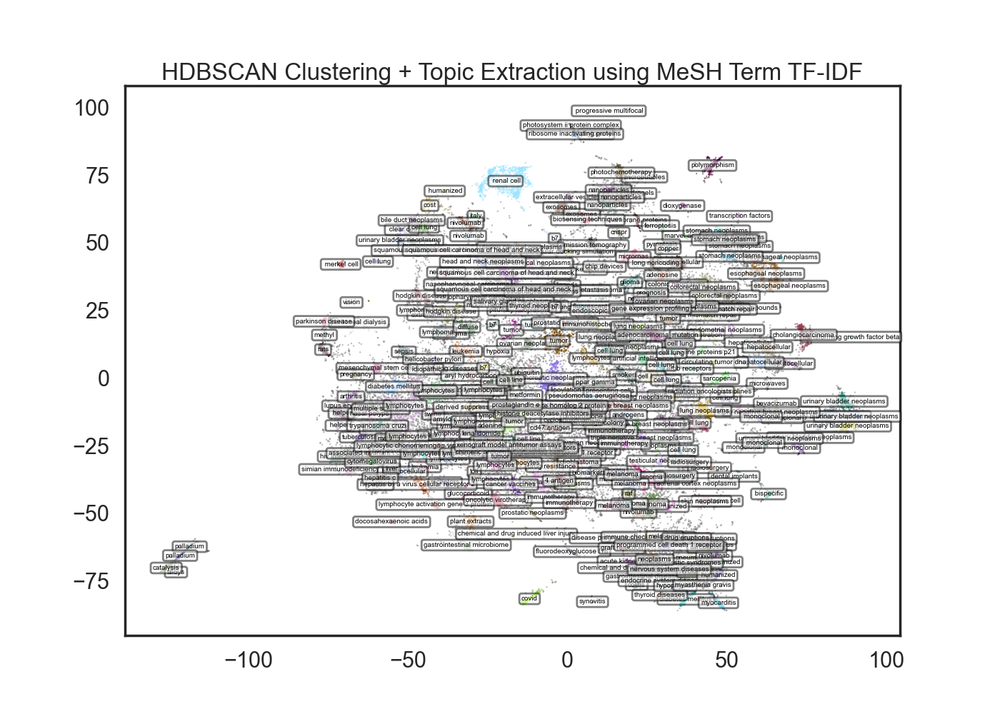

In [ ]:
plt.figure(figsize=(14, 10))

plt.scatter(X[:, 0], X[:, 1], c=cluster_colors, **plot_kwds)
plt.title('HDBSCAN Clustering + Topic Extraction using MeSH Term TF-IDF')

cluster_topics = get_cluster_topics_by_tfidf(clusterer, df, 'mesh_terms')

for label, center in get_cluster_centers(clusterer, X).items():
    plt.text(center[0], center[1], cluster_topics[label], 
        fontsize=7, color='black', ha='center', va='center',
        bbox=dict(facecolor='white', edgecolor='black', boxstyle='round', alpha=0.5))

plt.show()

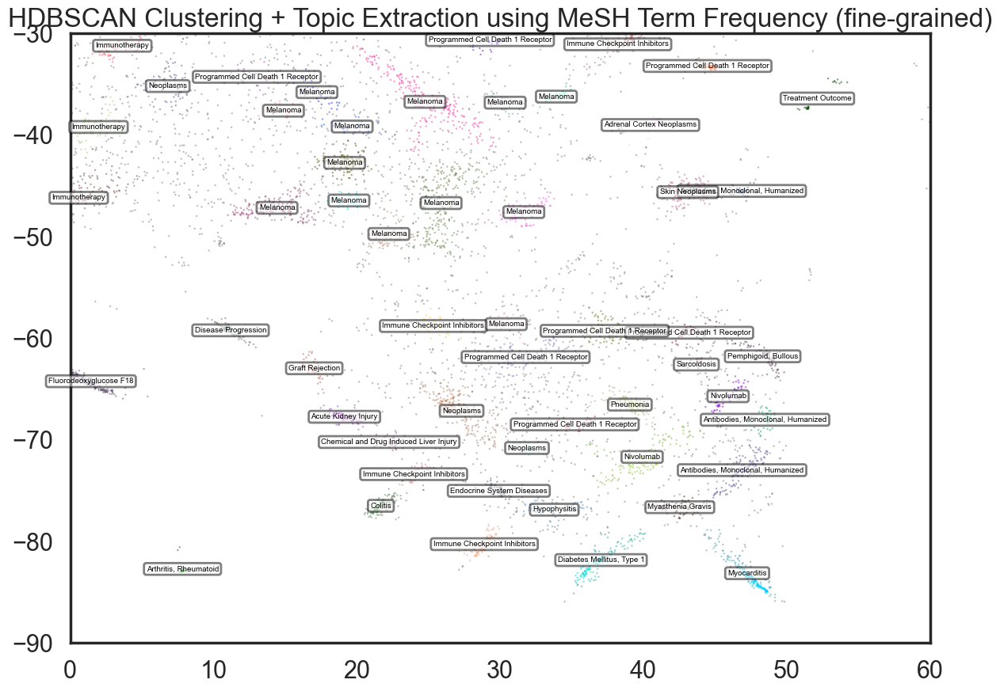

In [ ]:
plt.figure(figsize=(14, 10))

plt.xlim(0, 60)
plt.ylim(-90, -30)

plt.scatter(X[:, 0], X[:, 1], c=cluster_colors, **plot_kwds)
plt.title('HDBSCAN Clustering + Topic Extraction using MeSH Term Frequency (fine-grained)')

cluster_topics = get_cluster_topics_by_frequency(clusterer, df, 'mesh_terms')

for label, center in get_cluster_centers(clusterer, X).items():
    if 0 <= center[0] <= 60 and -90 <= center[1] <= -30:
        plt.text(center[0], center[1], cluster_topics[label], 
            fontsize=7, color='black', ha='center', va='center',
            bbox=dict(facecolor='white', edgecolor='black', boxstyle='round', alpha=0.5))

plt.show()

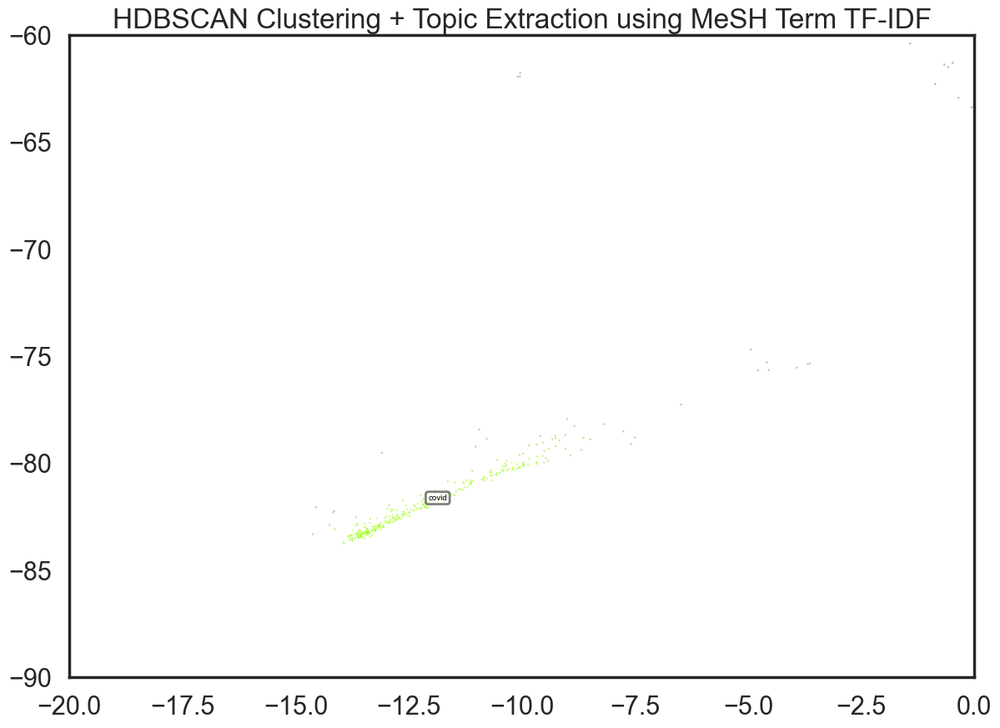

In [ ]:
plt.figure(figsize=(14, 10))

plt.xlim(-20, 0)
plt.ylim(-90, -60)
plt.scatter(X[:, 0], X[:, 1], c=cluster_colors, **plot_kwds)
plt.title('HDBSCAN Clustering + Topic Extraction using MeSH Term TF-IDF')

cluster_topics = get_cluster_topics_by_tfidf(clusterer, df, 'mesh_terms')

for label, center in get_cluster_centers(clusterer, X).items():
    if -20 <= center[0] <= 0 and -90 <= center[1] <= -60:
        plt.text(center[0], center[1], cluster_topics[label], 
            fontsize=7, color='black', ha='center', va='center',
            bbox=dict(facecolor='white', edgecolor='black', boxstyle='round', alpha=0.5))

plt.show()